Kaggle Notebook used as a reference : https://www.kaggle.com/code/burhanuddinlatsaheb/anime-faces-generation-using-gans
### Generative Adversarial Network for Anime Face Generation
In this project, we aim to create a Generative Adversarial Network (GAN) to generate anime faces. We will be using the Anime Face Dataset, which consists of more than 21,000 cropped anime faces in JPEG format.


Our goal is to train the GAN to generate high-quality, realistic anime faces that look similar to the images in the dataset. We will be using the Deep Convolutional GAN (DCGAN) architecture, which is a popular type of GAN that uses deep convolutional neural networks to generate high-quality images.

To train the model, we will use the Keras API with TensorFlow as the backend. We will also use other Python libraries such as NumPy and Matplotlib for data processing and visualization.

We will start by preprocessing the dataset, including resizing and normalizing the images. Then we will train the GAN for a specified number of epochs, adjusting hyperparameters such as the learning rate and optimizer as necessary. We will evaluate the model's performance by generating a set of images and comparing them to the real images in the dataset.

Overall, this project will demonstrate the use of GANs for image generation and the application of DCGAN architecture to generate high-quality anime faces.

This code imports necessary libraries such as os, numpy, matplotlib, warnings, tqdm, tensorflow, keras, and others. The os library is used for accessing the operating system functionalities, numpy is used for numerical computations, matplotlib is used for plotting graphs, warnings is used to ignore any warning messages, tqdm is used for creating progress bars, tensorflow and keras are used for building and training deep learning models, and other modules are imported for specific functionalities.

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

This code imports necessary libraries such as os, numpy, and PIL, and defines the variable data_dir as the path to the directory containing anime face images. The path is specific to the user's local machine, and may need to be changed depending on the location of the dataset.

In [2]:
import os
import numpy as np
from PIL import Image

data_dir = "C:/Users/varun/Downloads/PROJECT-2/anime-faces"

This code loads the complete image paths from the specified data_dir directory into a list called image_paths. It uses the os library to get a list of all file names in the data_dir directory, and then appends the full path of each file to the image_paths list using the os.path.join() function.

In [3]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(data_dir):
    image_path = os.path.join(data_dir, image_name)
    image_paths.append(image_path)

The len(image_paths) line returns the total number of image files (21,551) found in the data_dir directory.

In [4]:
len(image_paths)

21551

This code is used to display a grid of images in a 7x7 format. The images are loaded from the list of image paths generated in the previous code. The figure size of the plot is set to (20,20). The loop iterates through the first 49 image paths, loads each image using the load_img() function from keras, converts it into a numpy array using np.array(), and displays it using plt.imshow(). The plt.axis('off') function removes the axis labels from the plot. The index variable is incremented after displaying each image, so that the next image is displayed in the next grid cell.

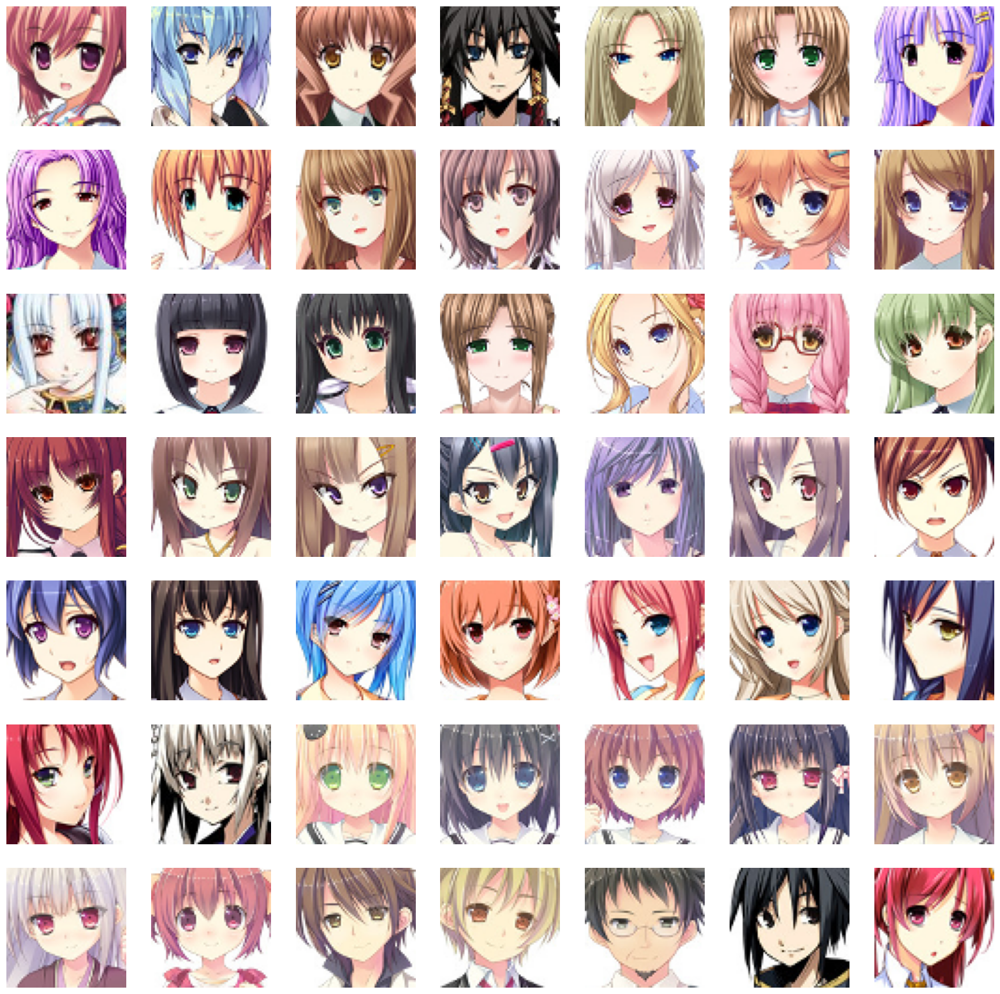

In [5]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

This code loads all the images from the image_paths list and converts them to numpy arrays. The load_img function from the tensorflow.keras.preprocessing.image module is used to load the image and tqdm is used for a progress bar. The resulting numpy arrays are stored in the train_images list and then converted to a numpy array using np.array(train_images).

In [6]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

This code retrieves the shape of the first image in the train_images array. It is likely being used to check the dimensions of the image data to ensure that it is properly loaded and formatted. The output of the code will be the shape of the image in the format (height, width, channels).

In [7]:
train_images[0].shape

(64, 64, 3)

The line of code is reshaping the train_images array to the shape of (number of images, height, width, channels) which is required by most deep learning frameworks including TensorFlow. Here, the train_images have 3 channels (RGB) and are of size 64x64 pixels. Additionally, the data type of the array is changed to float32 for better numerical precision during training.

In [8]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In machine learning models, it is a common practice to normalize the input data. Normalization helps in making the data consistent across all input variables and scales the data to the same range. In this code snippet, the pixel values of the images in train_images are normalized between -1 and 1. The value 127.5 is used because it is the mean value of the pixel range between 0 and 255. Subtracting 127.5 from each pixel value centers the pixel values around 0, and dividing by 127.5 scales the values between -1 and 1. This normalization technique helps in training machine learning models more efficiently.

In [9]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

This code defines some constants for the generator and discriminator models that will be used later in the code.

1. LATENT_DIM represents the dimension of the random noise vector that will be used as the input for the generator model.


2. WEIGHT_INIT defines the weight initialization method for the layers in both the generator and discriminator models.

3. CHANNELS represents the number of color channels in the input images. In this case, since the input images are RGB, CHANNELS is set to 3. If the input images were grayscale, CHANNELS would be set to 1.

In [10]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

In this code, a generator neural network model is defined using the Keras Sequential API. The generator is designed to take an input vector of size latent_dim which is set to 100. It has several layers of transposed convolutional layers with batch normalization and leaky ReLU activation functions. These layers are used to upsample the input vector to a 64x64 pixel image. The final layer uses a tanh activation function to ensure that the output is in the range of -1 to 1.

The summary function is called on the generator to print the details of each layer in the network along with the output shape of each layer.

In [11]:
from tensorflow.keras import layers

generator = Sequential(name='generator')

# input latent space vector
latent_dim = 100
generator.add(layers.Dense(4 * 4 * 256, input_dim=latent_dim))
generator.add(layers.Reshape((4, 4, 256)))
generator.add(layers.BatchNormalization())
generator.add(layers.LeakyReLU(alpha=0.2))

# upsample to 8x8
generator.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
generator.add(layers.BatchNormalization())
generator.add(layers.LeakyReLU(alpha=0.2))

# upsample to 16x16
generator.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
generator.add(layers.BatchNormalization())
generator.add(layers.LeakyReLU(alpha=0.2))

# upsample to 32x32
generator.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
generator.add(layers.BatchNormalization())
generator.add(layers.LeakyReLU(alpha=0.2))

# upsample to 64x64
generator.add(layers.Conv2DTranspose(3, (4, 4), strides=(2, 2), padding='same', activation='tanh'))

generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 4096)              413696    
                                                                 
 reshape (Reshape)           (None, 4, 4, 256)         0         
                                                                 
 batch_normalization (BatchN  (None, 4, 4, 256)        1024      
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 8, 8, 128)        524416    
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 8, 8, 128)        51

This code defines a discriminator model using the Keras API. The model is a Sequential model consisting of convolutional layers with batch normalization and LeakyReLU activation. The input shape is set to (64, 64, 3) which is the size of the images that will be passed to the discriminator. The model outputs a single sigmoid activated unit which predicts whether the input image is real or fake. The dropout layer is added to help prevent overfitting.

In [12]:
from keras.models import Sequential
from keras.layers import Conv2D, BatchNormalization, LeakyReLU, Flatten, Dropout, Dense

# define discriminator model
model = Sequential(name='discriminator')

input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(BatchNormalization())
model.add(LeakyReLU(alpha=alpha))

model.add(Conv2D(128, (4, 4), strides=(2, 2), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(alpha=alpha))

model.add(Conv2D(128, (4, 4), strides=(2, 2), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(alpha=alpha))

model.add(Flatten())
model.add(Dropout(0.3))

# output class
model.add(Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization_4 (Batc  (None, 32, 32, 64)       256       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_5 (Batc  (None, 16, 16, 128)      512       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 16, 16, 128)     

This code defines a custom Keras model class DCGAN which takes in a generator, discriminator, and latent dimension as arguments. It overrides the train_step method to perform one training step of both the discriminator and generator models using the given loss function and optimizers.

In each training step, it generates random noise and uses it to generate fake images with the generator model. Then, it trains the discriminator model with both the real and fake images and computes the corresponding losses. It also trains the generator model and computes its loss using the updated discriminator weights. Finally, it updates the state for both models and returns the current losses. The metrics property of the class returns the current generator and discriminator losses.

In [13]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

This is a custom callback class called DCGANMonitor that inherits from the keras.callbacks.Callback class. It is used to generate and display sample images during the training process of a DCGAN model.

The __init__ method initializes the callback with the number of images to generate (num_imgs) and the dimensionality of the latent space (latent_dim). It also creates a fixed random noise vector that will be used to generate the sample images.

The on_epoch_end method is called at the end of each training epoch. It generates a batch of fake images from the generator model using the fixed random noise vector, and then denormalizes the image values from [-1, 1] to [0, 255]. It then plots the generated images in a 5x5 grid and displays them.

The on_train_end method is called at the end of the entire training process. It saves the generator model to a file called 'generator.h5'.

Overall, this callback is useful for monitoring the progress of the generator model during training, and for visually inspecting the quality of the generated images over time.

In [14]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

This code initializes an instance of the DCGAN class, passing in the generator and discriminator models created earlier, as well as the LATENT_DIM variable specifying the dimension of the input noise vector for the generator. The dcgan instance can then be compiled and trained on a dataset using the compile() and fit() methods of the Model class.

In [15]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

The code above compiles the DCGAN model with stochastic gradient descent (SGD) optimizers for the generator and discriminator models, with specified learning rates and momentum. The binary cross-entropy loss function is used to train the model.

In [17]:
from tensorflow.keras.optimizers import SGD


D_LR = 0.0001 
G_LR = 0.0003
momentum = 0.9
d_optimizer = SGD(learning_rate=D_LR, momentum=momentum)
g_optimizer = SGD(learning_rate=G_LR, momentum=momentum)

dcgan.compile(g_optimizer=g_optimizer, d_optimizer=d_optimizer, loss_fn=BinaryCrossentropy())

The code is training the DCGAN model on the train_images dataset for N_EPOCHS number of epochs, with a callback to generate sample images at the end of each epoch using the DCGANMonitor class.

Epoch 1/20
674/674 [==============================] - ETA: 0s - d_loss: 0.3956 - g_loss: 0.9060

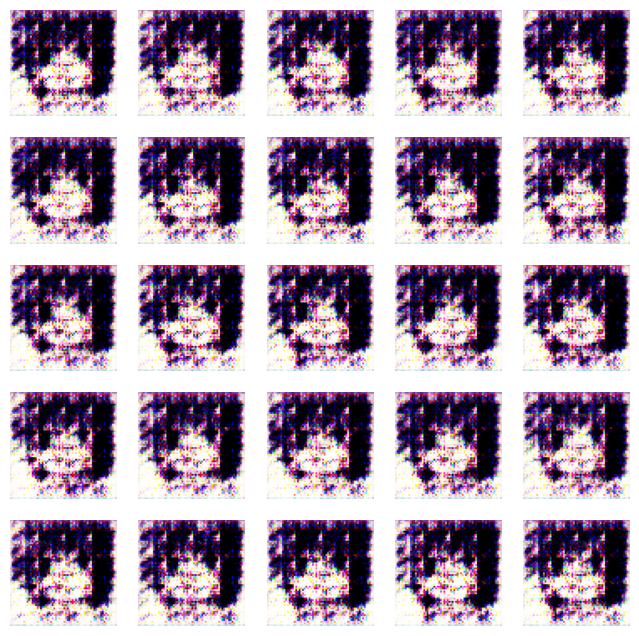

674/674 [==============================] - 309s 456ms/step - d_loss: 0.3956 - g_loss: 0.9060
Epoch 2/20
674/674 [==============================] - ETA: 0s - d_loss: 0.1859 - g_loss: 1.0444

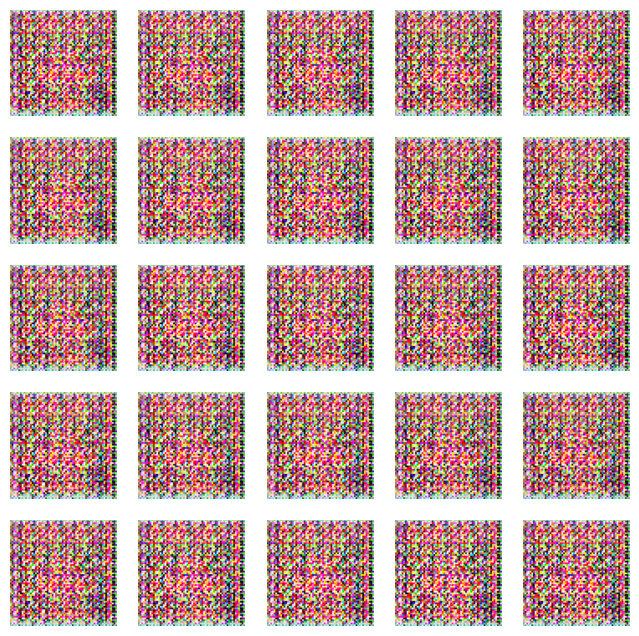

674/674 [==============================] - 308s 457ms/step - d_loss: 0.1859 - g_loss: 1.0444
Epoch 3/20
674/674 [==============================] - ETA: 0s - d_loss: 0.1765 - g_loss: 1.8217

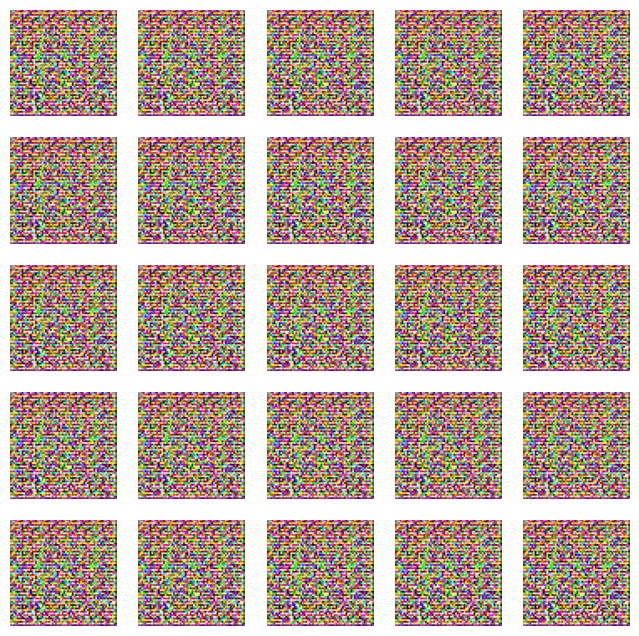

674/674 [==============================] - 304s 451ms/step - d_loss: 0.1765 - g_loss: 1.8217
Epoch 4/20
674/674 [==============================] - ETA: 0s - d_loss: 0.0581 - g_loss: 2.1704

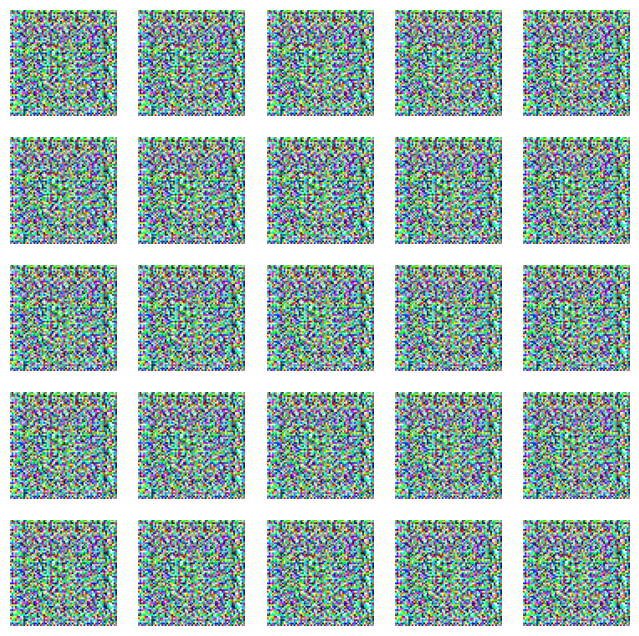

674/674 [==============================] - 309s 458ms/step - d_loss: 0.0581 - g_loss: 2.1704
Epoch 5/20
674/674 [==============================] - ETA: 0s - d_loss: -0.0439 - g_loss: 2.2279

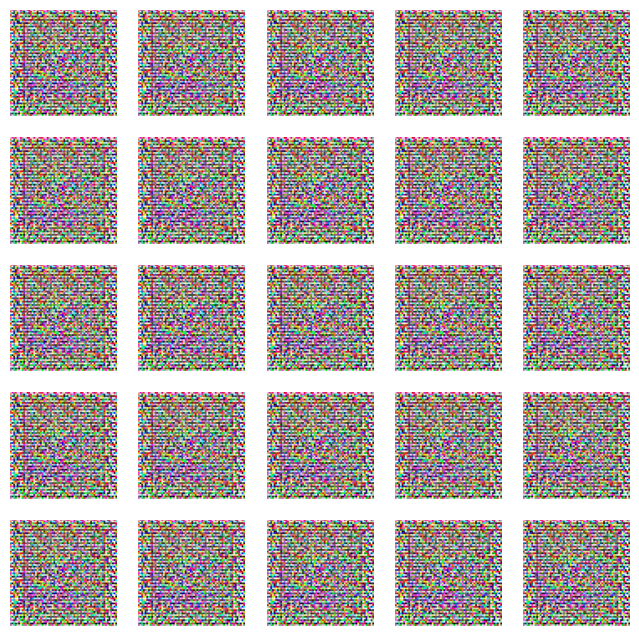

674/674 [==============================] - 325s 482ms/step - d_loss: -0.0439 - g_loss: 2.2279
Epoch 6/20
 26/674 [>.............................] - ETA: 6:04 - d_loss: -0.0771 - g_loss: 2.3734

KeyboardInterrupt: 

In [18]:
N_EPOCHS = 20
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

It is mentioned that SGD was stopped after 5 epochs because it was not giving good images after every epoch. This suggests that the model was not learning well using SGD optimizer and was not able to generate good quality images. This is a common scenario in deep learning where it may take some experimentation to find the best optimizer and hyperparameters for a given task. In this case, switching to Adam optimizer proved to be more effective in generating good quality images.

Adam optimizer is a popular optimization algorithm for training neural networks. It is an extension of stochastic gradient descent (SGD) that adapts the learning rate on a per-parameter basis. Adam combines the advantages of two other optimization methods: AdaGrad and RMSProp.

The key idea behind Adam is to compute a separate learning rate for each parameter by using an estimate of the first and second moments of the gradients. The first moment estimate (the mean) is similar to the exponentially weighted moving average used in RMSProp, while the second moment estimate (the variance) is similar to that used in AdaGrad.

Adam has been shown to work well in practice for a wide range of deep learning tasks and is often the default optimizer used in many neural network frameworks.

The below code sets the hyperparameters for the Adam optimizer, which is an alternative to SGD. Adam is an adaptive learning rate optimization algorithm that is well-suited for training deep neural networks.

In this code, we set the learning rates for the discriminator and generator, as well as the beta_1 parameter, which controls the exponential decay rate for the first moment estimates in Adam. Then, we compile the DCGAN model using the Adam optimizer for both the discriminator and generator, and the BinaryCrossentropy loss function.

In [19]:
D_LR = 0.0001 
G_LR = 0.0003
beta_1 = 0.5
d_optimizer = Adam(learning_rate=D_LR, beta_1=beta_1)
g_optimizer = Adam(learning_rate=G_LR, beta_1=beta_1)

dcgan.compile(g_optimizer=g_optimizer, d_optimizer=d_optimizer, loss_fn=BinaryCrossentropy())

This code snippet is training the DCGAN model on the train_images dataset for 20 epochs using the Adam optimizer with a learning rate of 0.0003 for the generator and 0.0001 for the discriminator. The BinaryCrossentropy() function is used as the loss function for the model.

During training, the DCGANMonitor() callback is used to generate and display 25 sample images after each epoch. These images are generated using random noise as input to the generator network.

After training is complete, the generator model is saved to a file named generator.h5.

Epoch 1/20
674/674 [==============================] - ETA: 0s - d_loss: -0.3957 - g_loss: 1.2333

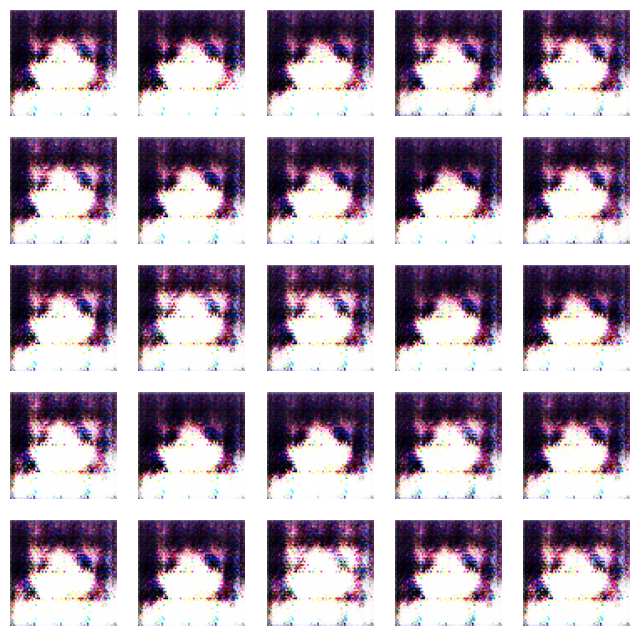

674/674 [==============================] - 345s 507ms/step - d_loss: -0.3957 - g_loss: 1.2333
Epoch 2/20
674/674 [==============================] - ETA: 0s - d_loss: -0.8743 - g_loss: 0.3476

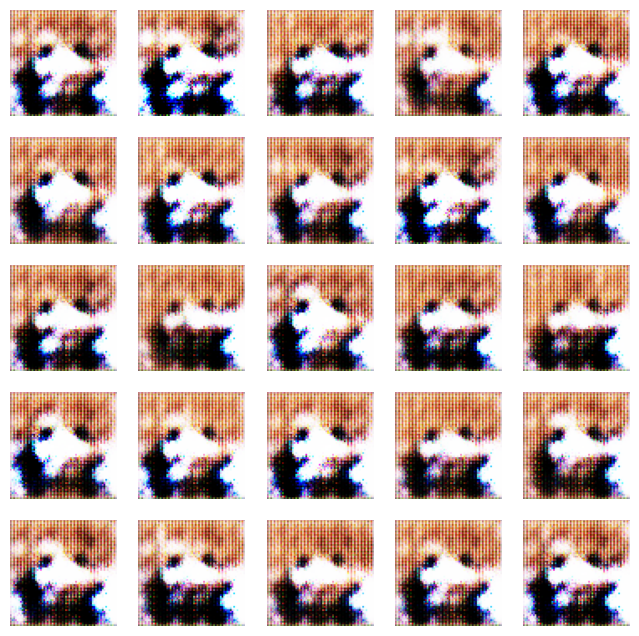

674/674 [==============================] - 343s 509ms/step - d_loss: -0.8743 - g_loss: 0.3476
Epoch 3/20
674/674 [==============================] - ETA: 0s - d_loss: -1.4033 - g_loss: 1.6188

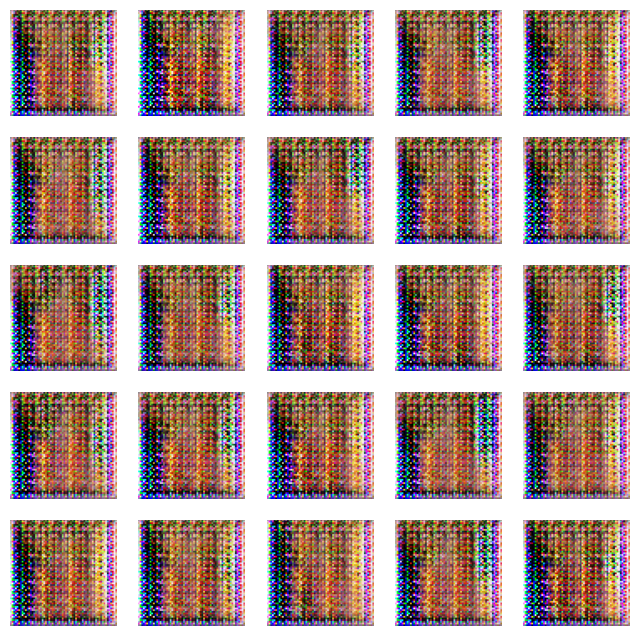

674/674 [==============================] - 341s 506ms/step - d_loss: -1.4033 - g_loss: 1.6188
Epoch 4/20
674/674 [==============================] - ETA: 0s - d_loss: -0.5948 - g_loss: 1.4178

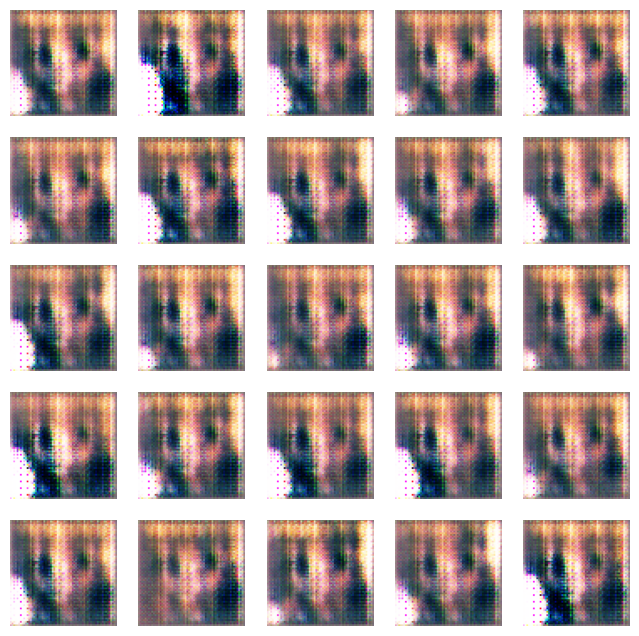

674/674 [==============================] - 337s 499ms/step - d_loss: -0.5948 - g_loss: 1.4178
Epoch 5/20
674/674 [==============================] - ETA: 0s - d_loss: -0.6558 - g_loss: 0.8185

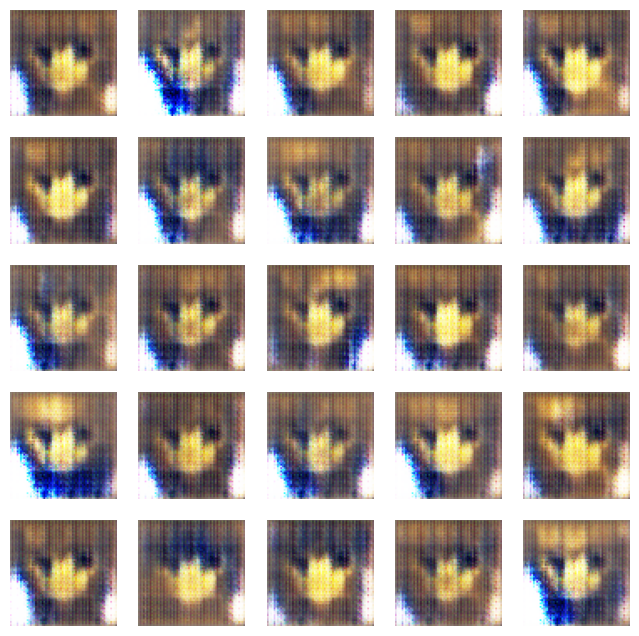

674/674 [==============================] - 323s 479ms/step - d_loss: -0.6558 - g_loss: 0.8185
Epoch 6/20
674/674 [==============================] - ETA: 0s - d_loss: -0.9508 - g_loss: 0.3173

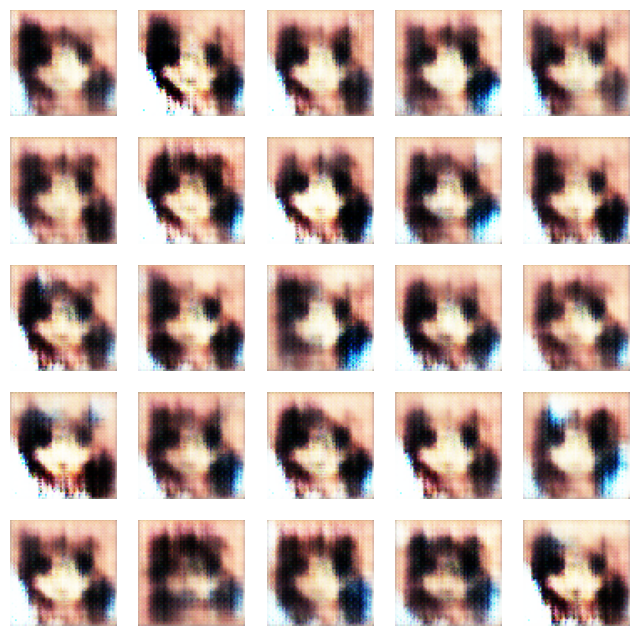

674/674 [==============================] - 321s 476ms/step - d_loss: -0.9508 - g_loss: 0.3173
Epoch 7/20
674/674 [==============================] - ETA: 0s - d_loss: 0.1630 - g_loss: 1.2218

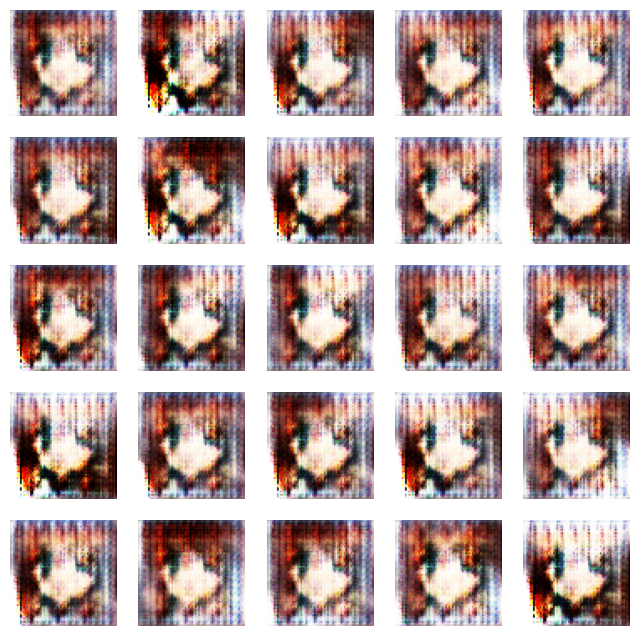

674/674 [==============================] - 339s 502ms/step - d_loss: 0.1630 - g_loss: 1.2218
Epoch 8/20
674/674 [==============================] - ETA: 0s - d_loss: 0.3160 - g_loss: 0.5042

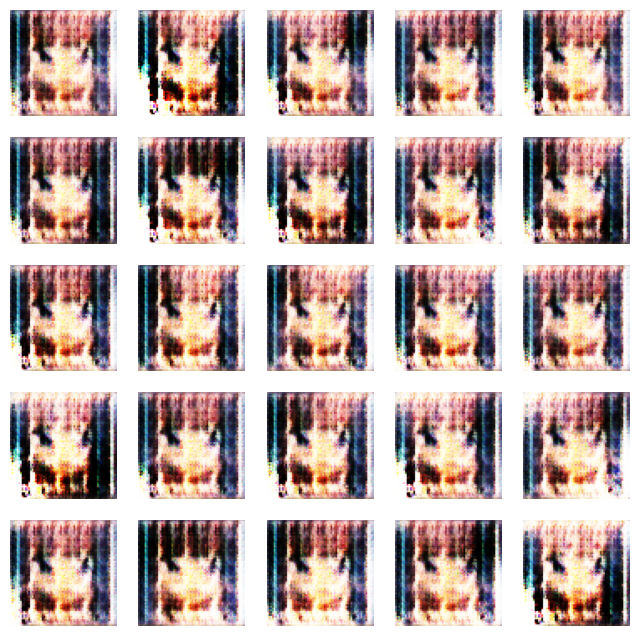

674/674 [==============================] - 324s 481ms/step - d_loss: 0.3160 - g_loss: 0.5042
Epoch 9/20
674/674 [==============================] - ETA: 0s - d_loss: -0.0099 - g_loss: 0.4194

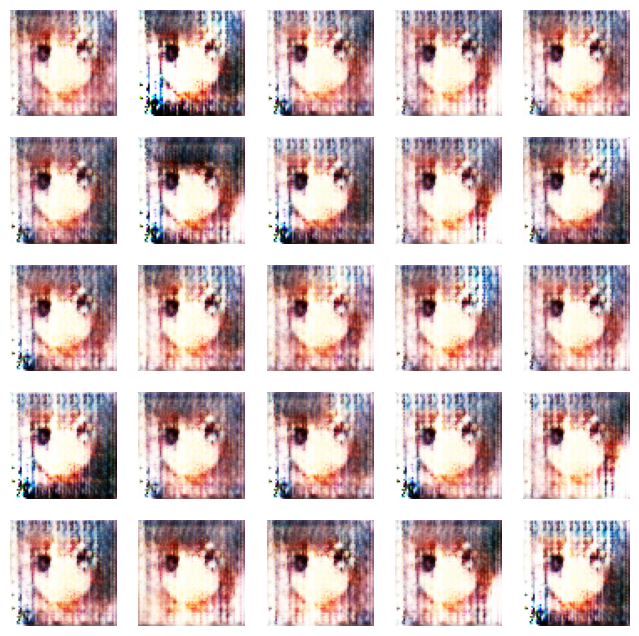

674/674 [==============================] - 331s 491ms/step - d_loss: -0.0099 - g_loss: 0.4194
Epoch 10/20
674/674 [==============================] - ETA: 0s - d_loss: 0.1228 - g_loss: 0.4148

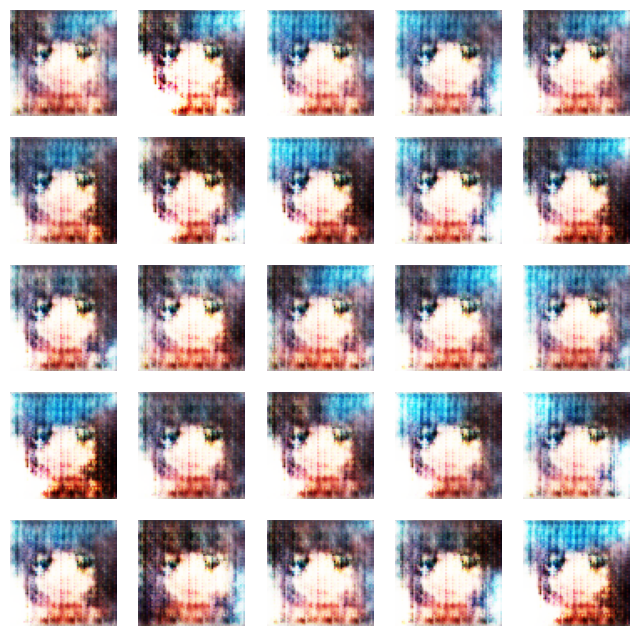

674/674 [==============================] - 329s 488ms/step - d_loss: 0.1228 - g_loss: 0.4148
Epoch 11/20
674/674 [==============================] - ETA: 0s - d_loss: -0.7411 - g_loss: 0.6162

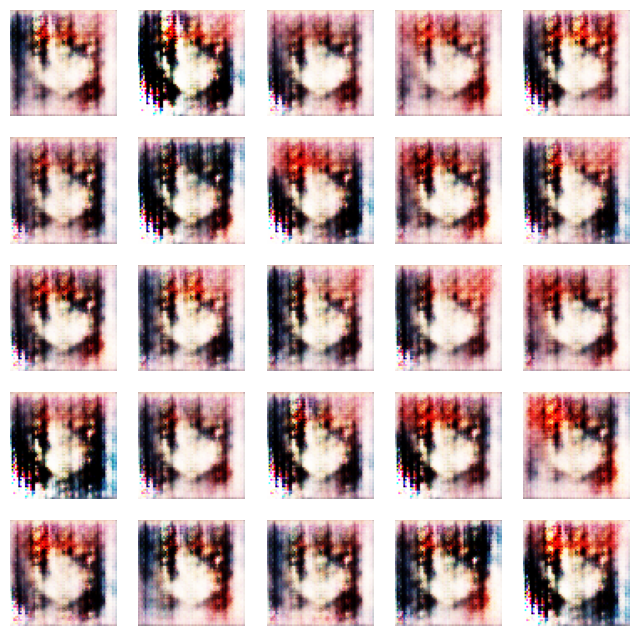

674/674 [==============================] - 326s 484ms/step - d_loss: -0.7411 - g_loss: 0.6162
Epoch 12/20
674/674 [==============================] - ETA: 0s - d_loss: -0.4499 - g_loss: 1.3225

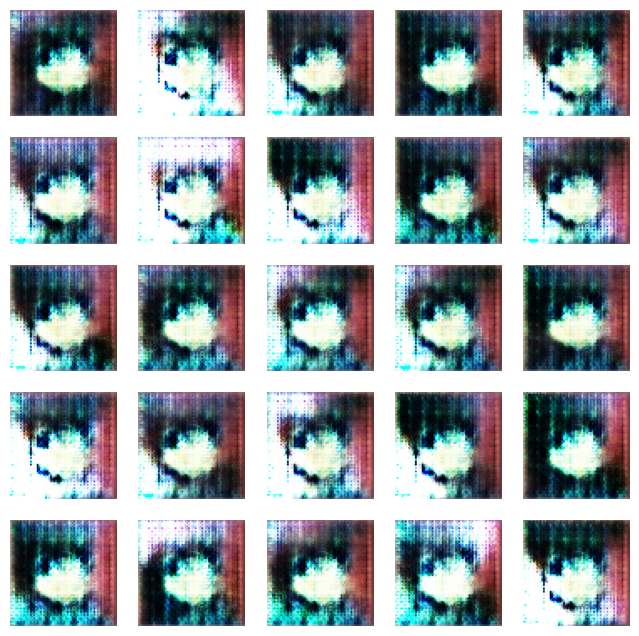

674/674 [==============================] - 327s 485ms/step - d_loss: -0.4499 - g_loss: 1.3225
Epoch 13/20
674/674 [==============================] - ETA: 0s - d_loss: -1.9572 - g_loss: 0.8508

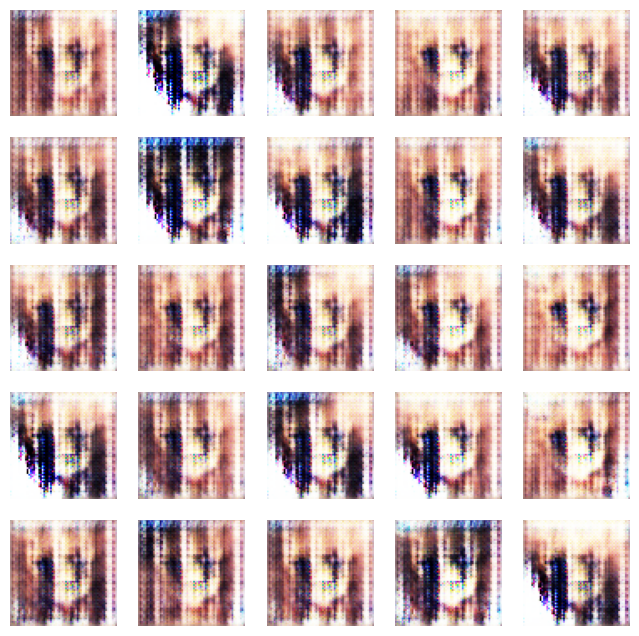

674/674 [==============================] - 326s 484ms/step - d_loss: -1.9572 - g_loss: 0.8508
Epoch 14/20
674/674 [==============================] - ETA: 0s - d_loss: -1.7022 - g_loss: 1.8558

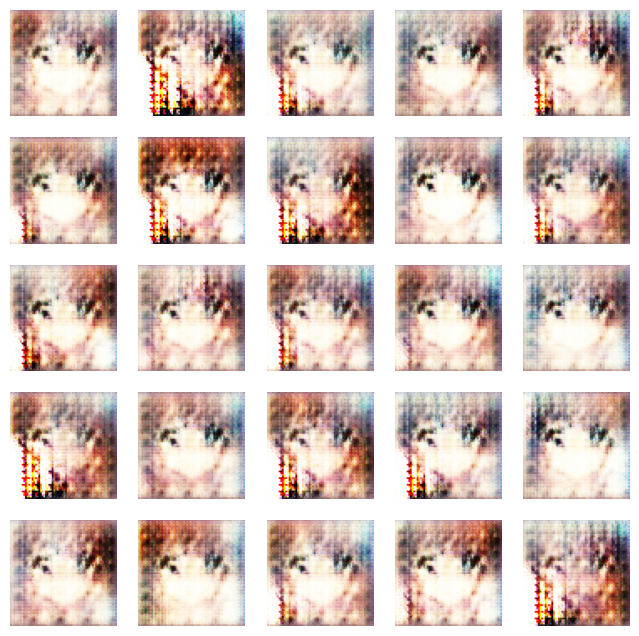

674/674 [==============================] - 328s 486ms/step - d_loss: -1.7022 - g_loss: 1.8558
Epoch 15/20
674/674 [==============================] - ETA: 0s - d_loss: -0.1676 - g_loss: 0.9562

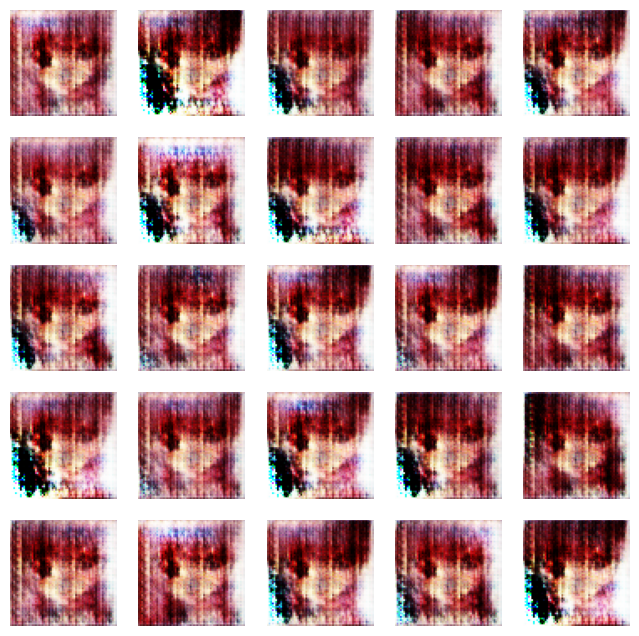

674/674 [==============================] - 330s 489ms/step - d_loss: -0.1676 - g_loss: 0.9562
Epoch 16/20
674/674 [==============================] - ETA: 0s - d_loss: -1.6846 - g_loss: 3.0836

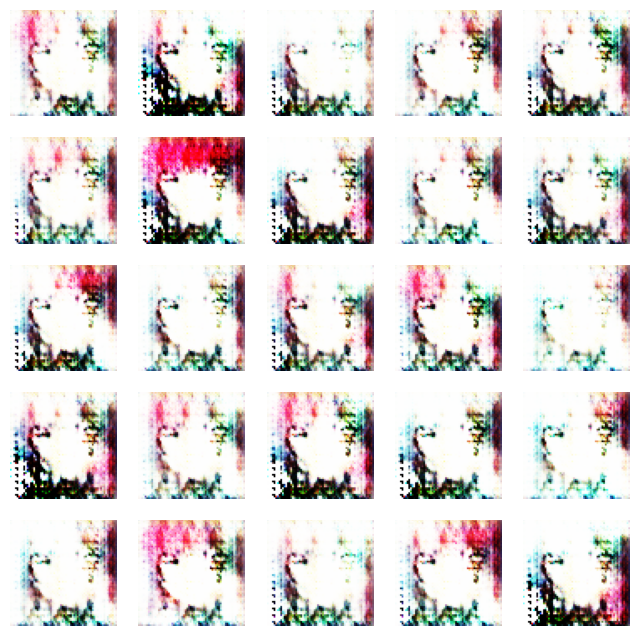

674/674 [==============================] - 330s 490ms/step - d_loss: -1.6846 - g_loss: 3.0836
Epoch 17/20
674/674 [==============================] - ETA: 0s - d_loss: -0.3200 - g_loss: 1.1670

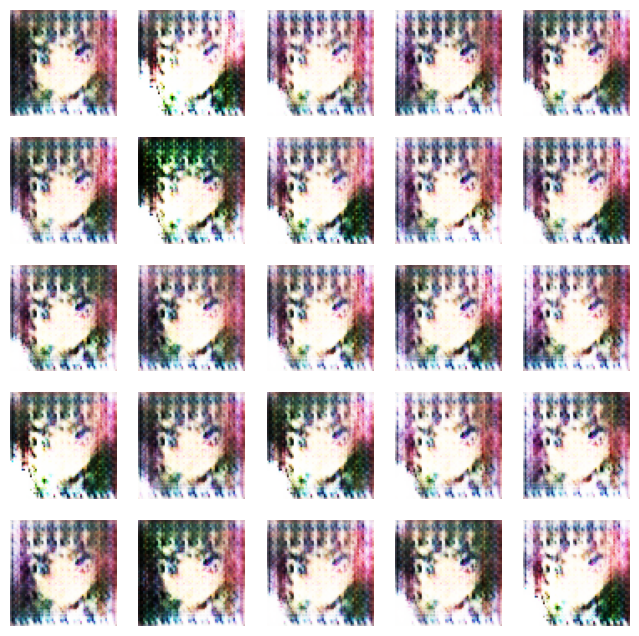

674/674 [==============================] - 326s 483ms/step - d_loss: -0.3200 - g_loss: 1.1670
Epoch 18/20
674/674 [==============================] - ETA: 0s - d_loss: 0.1728 - g_loss: 1.1299

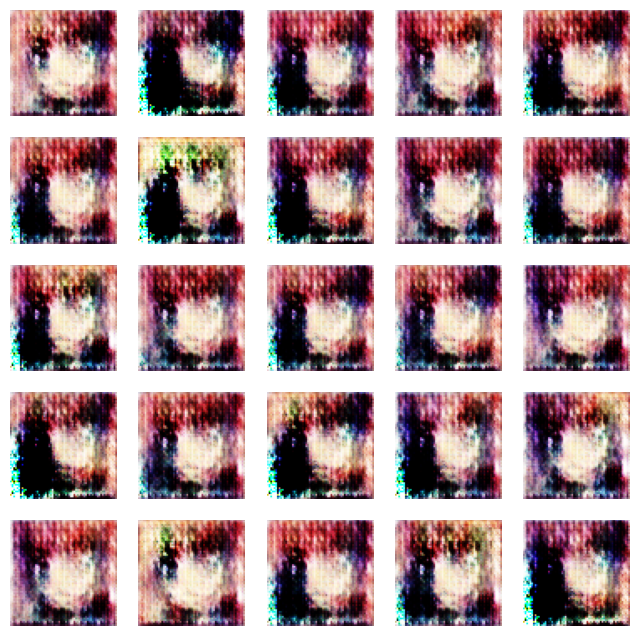

674/674 [==============================] - 324s 481ms/step - d_loss: 0.1728 - g_loss: 1.1299
Epoch 19/20
674/674 [==============================] - ETA: 0s - d_loss: -0.6022 - g_loss: 1.1659

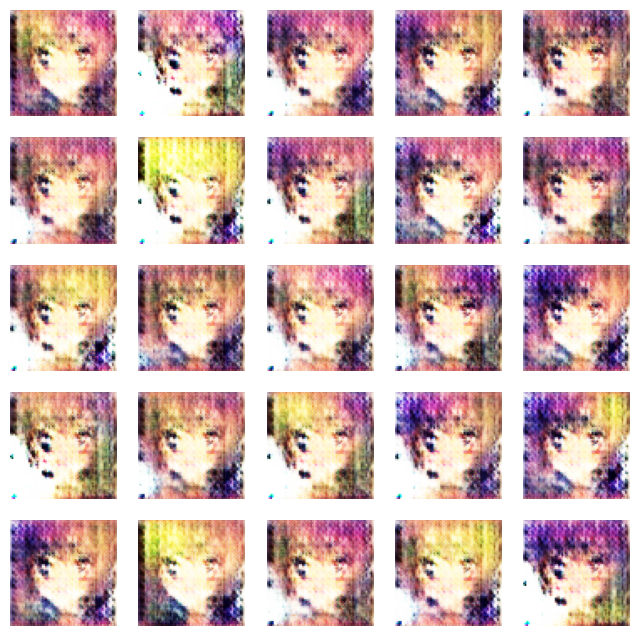

674/674 [==============================] - 318s 471ms/step - d_loss: -0.6022 - g_loss: 1.1659
Epoch 20/20
674/674 [==============================] - ETA: 0s - d_loss: -0.3005 - g_loss: 1.7034

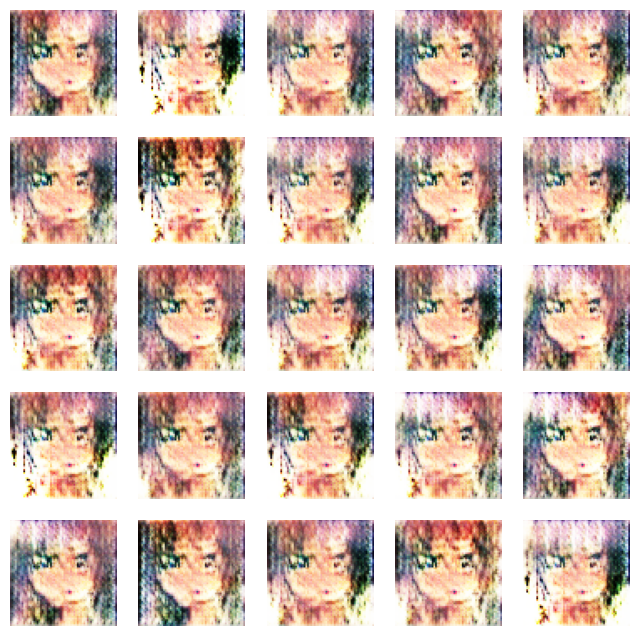

674/674 [==============================] - 330s 490ms/step - d_loss: -0.3005 - g_loss: 1.7034


In [20]:
N_EPOCHS = 20
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

The below code uses Matplotlib library to visualize the loss curves of both the generator and discriminator during training.

First, it creates a figure with two subplots, one for the discriminator loss and the other for the generator loss. Then, it iterates over the history object passed as an argument and plots the loss values for each epoch.

The discriminator loss is plotted in blue color and the generator loss is plotted in orange color. The title and axis labels are set accordingly. Finally, the show method is called to display the figure.

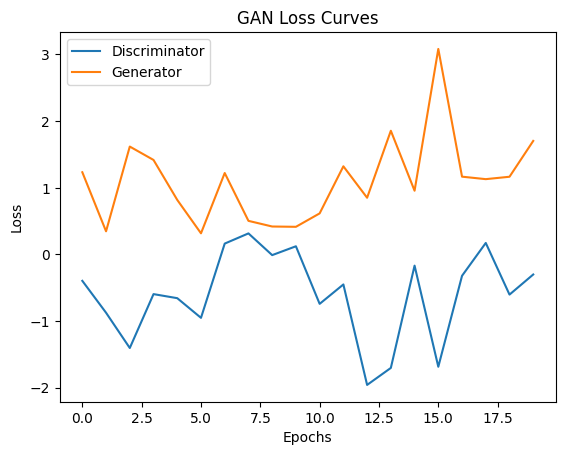

In [21]:
import matplotlib.pyplot as plt

# Get the discriminator and generator loss histories
d_loss_history = dcgan.history.history['d_loss']
g_loss_history = dcgan.history.history['g_loss']

# Plot the loss curves
plt.plot(d_loss_history, label='Discriminator')
plt.plot(g_loss_history, label='Generator')
plt.title('GAN Loss Curves')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

### Let's generate 1 image to try how our model is performing

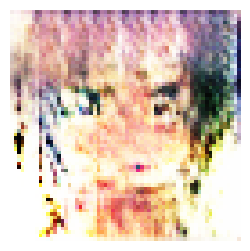

In [30]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

### Let's generate 5 more images 

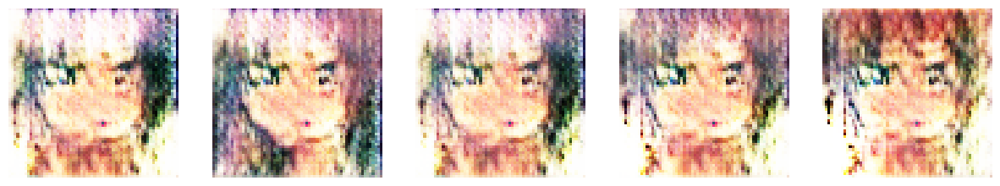

In [31]:
noise = tf.random.normal([5, 100])
fig, axes = plt.subplots(1, 5, figsize=(15,15))

for i in range(5):
    # generate the image from noise
    g_img = dcgan.generator(tf.reshape(noise[i], [1, 100]))
    # denormalize the image
    g_img = (g_img * 127.5) + 127.5
    g_img.numpy()
    img = array_to_img(g_img[0])
    axes[i].imshow(img)
    axes[i].axis('off')
    
plt.show()

The model still needs to be improved may be trained on 50-100 epochs to get the better results.

### In Future Improvements using VAE(VAriational Autoencoder)
We can also apply VAE (Variational Autoencoder) instead of GAN (Generative Adversarial Network) for image generation. VAE is a type of generative model that can learn to generate new images by mapping a lower-dimensional latent space to a higher-dimensional space of images.

One of the advantages of VAEs over GANs is that VAEs provide a more stable training process and can produce more diverse images, while GANs tend to produce sharper images but can be more challenging to train. However, both VAEs and GANs have their strengths and weaknesses, and the choice between them ultimately depends on the specific use case and the desired outcome.

### Resources

1. Dataset Used - https://www.kaggle.com/datasets/soumikrakshit/anime-faces

2. Kaggle Notebook used aa a reference - https://www.kaggle.com/code/burhanuddinlatsaheb/anime-faces-generation-using-gans

3. ModelZoo DCGAN - https://modelzoo.co/model/ganotebooks

4. GAN on Anime Face Article - https://aihalapathirana.medium.com/generative-adversarial-networks-for-anime-face-generation-pytorch-1b4037930e21

